# <center>Analisando dados CAPNOBASE PPG - Respiração</center>

Os dados originais (https://dataverse.scholarsportal.info/dataset.xhtml?persistentId=doi:10.5683/SP2/NLB8IT) foram adquiridos de 42 pacientes durante cirurgia eletiva e anestesia de rotina, com gravações de 8 minutos e cada uma contém:
<ul>
<li> Sinal PPG bruto para 42 casos de 8 min de duração; </li>
<li> pico de pulso e rótulos de artefatos validados por um avaliador especialista; </li>
<li> sinal de referência de CO2 e RR instantâneo derivado para todos os casos; </li>
<li> sinal de ECG de referência com rótulos de pico R e artefato, validado por um avaliador especialista;</li>
<li> referência de FC instantânea derivada de rótulos de pico de pulso de ECG e PPG;</li>
<li> saída do algoritmo SmartFusion e subcomponentes quando aplicado a este conjunto de dados de referência para comparação com seu algoritmo.</li>
</ul>

## Dados Formato MAT

Arquivos CSV separados são fornecidos para cada gravação (onde ## é o número do paciente), contendo:
<ul>
<li> param: taxas de amostragem e nome do caso, modo de ventilação; </li>
<li> meta: meta-informações como dados demográficos; </li>
<li> sinal: sinais brutos de co2 e pleth; </li>
<li> rótulos: rótulos para batimentos, respirações e artefatos obtidos de um avaliador humano;</li>
<li> referência: tendências derivadas a partir de rótulos; </li>
<li> SResultados: RR obtido usando a abordagem Smart Fusion e suas etapas. </li>
</ul>

In [47]:
%%time
import pandas as pd
import os
import plotly
import plotly.offline as py
import plotly.graph_objs as go
import numpy  as np
import h5py

from scipy.fft import fft, fftfreq, ifft
from datetime import datetime
from plotly.subplots import make_subplots
from scipy.signal import find_peaks
from scipy.interpolate import interp1d
from openpyxl import load_workbook
from scipy.signal import butter, lfilter, freqz, sosfilt
from PyEMD import EMD


#pasta para salvar os arquivos
os.chdir("C:\\Users\\ayalo\\PPG\\RESULTADOS\\CAPNOBASE" )

# Inicializa o modo Plotly Notebook 
py.init_notebook_mode(connected=False)

Wall time: 56 ms


In [70]:
#Data CAPNOBASE
#144001 amostras
num_arquivos = 42
fre_sinal = 300

#dados manipulaveis
frequencia = 300
inicio = 60
fim = 420
#fim = 171
#fim = 201
janela = 60

amostras1 = inicio * fre_sinal
amostras = fim * fre_sinal
N = amostras - amostras1

N_PPG = (480 * frequencia)
N_JANELA = janela * frequencia
N_JANELA_NORMAL = janela * fre_sinal
janela_tempo = fim - (inicio + janela) #quantidade de repetiçoes

In [65]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

def manipulation_frequency(array):
    array = np.asarray(array)
    vetor = np.zeros(N_PPG)
    for i in range(N_PPG):
        vetor[i] = array[i*int(fre_sinal/frequencia)]
    return vetor 

def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a


In [66]:
%%time

#Cria Matriz Vazia
PPG_cap = np.empty((num_arquivos, N_PPG))
CO2_cap = np.empty((num_arquivos, 144000))
rpm_cap = np.empty((num_arquivos, 321))
rpms_cap = np.empty((num_arquivos, 321))

for i in range(num_arquivos):
    caminhoCAPNOBASE  = "C:\\Users\\ayalo\\PPG\\DADOS\\capnobase_mat\\8min ("+str(i+1)+").mat"
    f = h5py.File(caminhoCAPNOBASE,'r') 
    data = f.get('/signal/pleth/y')
    data = np.array(data)
    data = data[0][0:144000]
    PPG_cap[i] = manipulation_frequency(data)
    
    data = f.get('/signal/co2/y')
    data = np.array(data)
    CO2_cap[i] = data[0][0:144000]
        
    data = f.get('/reference/rr/co2/x')
    data = np.array(data).transpose()
    data = data[0]*300
    data = np.round(data,0)

    x = np.where(data == (find_nearest(data, amostras1)))
    x = x[0][0]
    y = np.where(data == (find_nearest(data, amostras)))
    y = y[0][0]

    rpms_cap[i] = 0
    rpms_cap[i][x:y] = data[x:y]
    


    data = f.get('/reference/rr/co2/y')
    data = np.array(data).transpose()
    data = data[0]
    
    rpm_cap[i] = 0
    rpm_cap[i][x:y] = data[x:y]
    
rpm_cap[np.isinf(rpm_cap)] = 0
rpm_cap[np.isnan(rpm_cap)] = 0

Wall time: 2.41 s


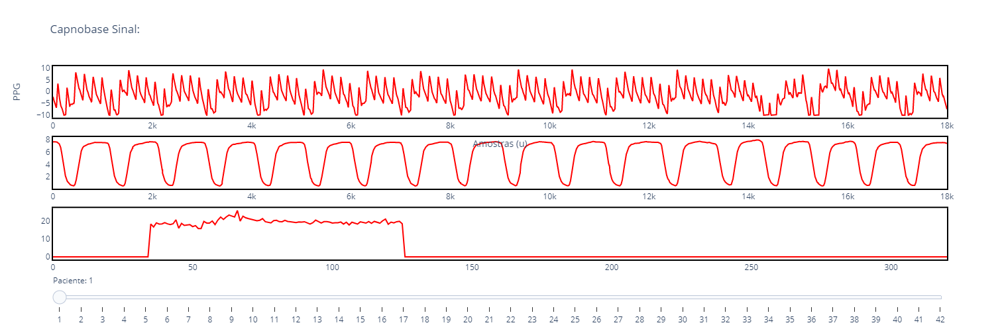

Wall time: 4.58 s


In [10]:
%%time
linhas = 3

# Create figure
fig = make_subplots(rows=linhas, cols=1)
# Add all traces of pacient
for i in range(num_arquivos):
    fig.add_scatter(y=PPG_cap[i][42000:60000],
                    row=1, col=1, visible=False,
                    showlegend = False,
                    name = "(x,y)",
                    marker_color="red")
# Add all traces of pacient
for i in range(num_arquivos):
    fig.add_scatter(y=CO2_cap[i][42000:60000],
                    row=2, col=1, visible=False,
                    showlegend = False,
                    name = "(x,y)",
                    marker_color="red")
for i in range(num_arquivos):
    fig.add_scatter(y=rpm_cap[i],
                    row=3, col=1, visible=False,
                    showlegend = False,
                    name = "(x,y)",
                    marker_color="red")

# Make 10th trace visible
for i in range(linhas):
    fig.data[i*num_arquivos].visible = True


# Create and add slider
steps = []
for i in range(num_arquivos):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],  # layout attribute
    )
    for k in range(linhas):
        step["args"][0]["visible"][i+(k*num_arquivos)] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    steps=steps
)]

# Update xaxis properties
fig.update_xaxes(title_text="Amostras (u)", row=1, col=1)
fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

# Update yaxis properties
fig.update_yaxes(title_text="PPG", row=1, col=1)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

fig.update_layout(
    title="Capnobase Sinal:",
    sliders=sliders,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

# Edit slider labels
fig['layout']['sliders'][0]['currentvalue']['prefix']='Paciente: '
for i in range(num_arquivos):
    fig['layout']['sliders'][0]['steps'][i]['label']=i+1
fig.show()

In [71]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1
T = 1 / fre_sinal
T_PPG = 1 / frequencia
for i in range(42):
    #VALOR CO2
    #sinal original com aumento das extremidades e remoção do sinal DC por media
    y0 = CO2_cap[i][cp1:cp2]
 
    # plt.figure(figsize=(16, 10))
    # plt.subplot(2, 1, 1)
    # plt.plot(sinal_CO2)

    yf3 = fft(y0)
    xf3 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
    yf3 = np.abs(yf3[0:N_JANELA//2])     

    fyy = xf3[5] - xf3[4]
    p1 = int(0.1/fyy)
    p2 = int(0.7/fyy)

    pos_y = yf3[p1:p2].argmax()
    val_x = xf3[pos_y+p1]
    print(val_x*60)

#     plt.subplot(2, 1, 2)
#     plt.plot(xf3[p1:p2],yf3[p1:p2])

#     plt.show()

16.999999999999996
28.999999999999993
9.999999999999998
36.999999999999986
23.999999999999993
11.999999999999996
9.999999999999998
34.99999999999999
9.999999999999998
11.999999999999996
21.999999999999996
17.999999999999996
17.999999999999996
10.999999999999998
9.999999999999998
37.99999999999999
8.999999999999998
8.999999999999998
10.999999999999998
13.999999999999996
17.999999999999996
12.999999999999996
9.999999999999998
13.999999999999996
14.999999999999996
10.999999999999998
9.999999999999998
9.999999999999998
10.999999999999998
8.999999999999998
11.999999999999996
6.999999999999998
9.999999999999998
16.999999999999996
9.999999999999998
9.999999999999998
9.999999999999998
13.999999999999996
13.999999999999996
26.999999999999993
15.999999999999996
8.999999999999998


In [85]:
%%time
resultado33 = np.empty((num_arquivos,4*janela_tempo))

contador_acertou = 0
contador_sinalruim = 0

for kk in range(janela_tempo):
    ######################################################################### FFT ##########################################################################################################################
    # sample spacing
    T = 1 / fre_sinal
    T_PPG = 1 / frequencia
    
    Xfft_PPG   = np.empty((num_arquivos, int(N_JANELA/2)))
    Yfft_PPG   = np.empty((num_arquivos, int(N_JANELA/2)))
    Xfft_CO2   = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    Yfft_CO2   = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    resultado  = np.empty((num_arquivos,5))
    sinal_ppg  = np.empty((num_arquivos,N_JANELA))

    FrPPG = np.array(range(num_arquivos))
    FrREF = np.array(range(num_arquivos))

    Erro_fft = np.array(range(num_arquivos))
    Erro_medido = np.array(range(num_arquivos))

    Y = np.linspace(1, 42, num_arquivos)
    for i in range(num_arquivos):
        
        cp1 = (kk * frequencia) + (frequencia * inicio) 
        cp2 = N_JANELA + cp1

        # #################################################################################fft
        # y0 = PPG_cap[i][cp1:cp2]
        # order = 5       
        # cutoff = 5
        # y0 = butter_lowpass_filter(y0, cutoff, frequencia, order)
        # #################################################################################fft

        #################################################################################linha de base/amplitude/frequencia      
        #sinal original com aumento das extremidades e remoção do sinal DC por media
        sinal_original = PPG_cap[i][cp1-2000:cp2+2000]
        order = 5       
        cutoff = 5
        sinal_original = butter_lowpass_filter(sinal_original, cutoff, frequencia, order)
        
        #pegando os picos e vales
        val_x_peaks_ac, _ = find_peaks(sinal_original, prominence=1)
        vales_x, _ = find_peaks((sinal_original*(-1)), prominence=1)
        #Diferença no numero de vales e picos é menor q 2
        if( abs(len(val_x_peaks_ac) - len(vales_x)) < 2):
            
#             ###############################AMPLITUDE    
#             #quantidade de picos menores/igual e primeiro pico começa antes do vale
#             if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#                 pedro = np.zeros(len(val_x_peaks_ac)-1)
#                 for z in range(len(pedro)-1):
#                     pedro[z] = sinal_original[val_x_peaks_ac[z+1]] - sinal_original[vales_x[z]]
                
#             #quantidade de picos menores/igual e primeiro pico começa depois do vale
#             elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#                 pedro = np.zeros(len(val_x_peaks_ac))
#                 for z in range(len(pedro)):
#                     pedro[z] = sinal_original[val_x_peaks_ac[z]] - sinal_original[vales_x[z]]

#             #quantidade de vales menores/igual e primeiro pico começa antes do vale
#             elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#                 pedro = np.zeros(len(vales_x)-1)
#                 for z in range(len(pedro)-1):
#                     pedro[z] = sinal_original[val_x_peaks_ac[z+1]] - sinal_original[vales_x[z]]

#             #quantidade de vales menores/igual e primeiro pico começa depois do vale
#             elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#                 pedro = np.zeros(len(vales_x))
#                 for z in range(len(pedro)):
#                     pedro[z] = sinal_original[val_x_peaks_ac[z]] - sinal_original[vales_x[z]]

#             else:
#                 www = www + 1
#                 print("condiçao maluca ver", inicio, fim, www)


#             s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
#             maria = np.zeros(len(sinal_original))
#             for aux3 in range(len(sinal_original)):
#                 maria[aux3] = s_a(aux3)    
#             y0 = maria[2000:(len(sinal_original)-2000)]
#             ###############################AMPLITUDE        
        
            # ###############################LINHA DE BASE            
            # l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
            # pedro = np.zeros(len(sinal_original))
            # for k in range(len(sinal_original)):
            #     pedro[k] = l_b(k)
            # y0 = pedro[2000:(len(sinal_original)-2000)]
            # ###############################LINHA DE BASE
            
            ###############################FREQUENCIA
            fm_y = np.zeros(len(val_x_peaks_ac)-1)
            for z in range(len(val_x_peaks_ac)-1):
                fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
            fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
            s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
            joao = np.zeros(len(sinal_original))
            for k in range(len(sinal_original)):
                joao[k] = s_f(k)
            y0 = joao[2000:(len(sinal_original)-2000)]
            ###############################FREQUENCIA
        else:
            contador_sinalruim = contador_sinalruim + 1
            
#         #############EMD
#         y0 = PPG_cap[i][cp1:cp2]
#         order = 5       
#         cutoff = 5
#         y0 = butter_lowpass_filter(y0, cutoff, frequencia, order)
#         time = np.linspace(0, 1, len(y0))
#         emd1 = EMD()
#         IMF = emd1.emd(y0, time)

#         #y0 = IMF[0] #IMF1
#         #y0 = IMF[1] #IMF2
#         #y0 = IMF[2] #IMF3
#         #y0 = IMF[3] #IMF4
#         #y0 = IMF[4] #IMF5
#         #############EMD
                
        yf0 = fft(y0)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])     

        fyy = xf0[5] - xf0[4]
        p1 = int(0.1/fyy)
        p2 = int(0.7/fyy)
        
        
        pos_y = yf0[p1:p2].argmax()
        val_x = xf0[pos_y+p1]
        FrPPG[i] = val_x*60
        
        
        #VALOR CO2
        sinal_CO2 = CO2_cap[i][cp1:cp2]
        yf1 = fft(sinal_CO2)
        xf1 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf1 = np.abs(yf1[0:N_JANELA//2])      

        fxx = xf1[5] - xf1[4]
        p3 = int(0.1/fxx)
        p4 = int(0.7/fxx)
                
        pos_yy = yf1[p3:p4].argmax()
        val_xx = xf1[pos_yy+p3]
        FrREF[i] = val_xx*60

        Erro_medido[i] = abs(FrREF[i] - FrPPG[i])
        if( Erro_medido[i]<=3 ):
            contador_acertou = contador_acertou + 1
        
        
        Y[i] = i + 1
        #resultado[i] = [ Y[i], FrPPG[i], FrCO2[i], FrREF[i], Erro_fft[i], Erro_medido[i] ]
        resultado[i] = [ Y[i], FrPPG[i], FrREF[i], FrREF[i], Erro_medido[i] ]

    ######################################################################################## salva excel #######################################################################################################
     
    resultado33[0:,(kk*4):(4+(kk*4))] = resultado[:,1:]
    
    print(kk)
    
data_array = resultado33
row_indices = resultado[:,0]
data_df = pd.DataFrame(data_array, index=row_indices)

book = load_workbook('erro.xlsx')
writer = pd.ExcelWriter('erro.xlsx', engine = 'openpyxl', mode='a')
writer.book = book
data_df.to_excel(writer, sheet_name="TUDO")
writer.close()

0
1
2
3
4
5
6
7


KeyboardInterrupt: 

In [86]:
contador_acertou

297

In [87]:
contador_sinalruim

0

In [42]:
%%time
resultado33 = np.empty((num_arquivos,4*janela_tempo))

contador_acertou = 0
contador_sinalruim = 0

for kk in range(janela_tempo):
    ######################################################################### FFT ##########################################################################################################################
    # sample spacing
    T = 1 / fre_sinal
    T_PPG = 1 / frequencia

    Xfft_PPG   = np.empty((num_arquivos, int(N_JANELA/2)))
    Yfft_PPG   = np.empty((num_arquivos, int(N_JANELA/2)))
    Xfft_CO2   = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    Yfft_CO2   = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    resultado  = np.empty((num_arquivos,5))
    sinal_ppg  = np.empty((num_arquivos,N_JANELA))

    FrMED = np.array(range(3))
    FrPPG = np.array(range(num_arquivos))
    FrREF = np.array(range(num_arquivos))

    Erro_fft = np.array(range(num_arquivos))
    Erro_medido = np.array(range(num_arquivos))

    Y = np.linspace(1, 42, num_arquivos)
    for i in range(num_arquivos):

        cp1 = (kk * frequencia) + (frequencia * inicio) 
        cp2 = N_JANELA + cp1

        # #################################################################################fft
        # y0 = PPG_cap[i][cp1:cp2]
        # order = 5       
        # cutoff = 5
        # y0 = butter_lowpass_filter(y0, cutoff, frequencia, order)
        # #################################################################################fft

        #################################################################################linha de base/amplitude/frequencia      
        #sinal original com aumento das extremidades e remoção do sinal DC por media
        sinal_original = PPG_cap[i][cp1-2000:cp2+2000]
        order = 5       
        cutoff = 5
        sinal_original = butter_lowpass_filter(sinal_original, cutoff, frequencia, order)
        
        #pegando os picos e vales
        val_x_peaks_ac, _ = find_peaks(sinal_original, prominence=1)
        vales_x, _ = find_peaks((sinal_original*(-1)), prominence=1)
        #Diferença no numero de vales e picos é menor q 2
        if( abs(len(val_x_peaks_ac) - len(vales_x)) < 2):
            
            ###############################AMPLITUDE    
            #quantidade de picos menores/igual e primeiro pico começa antes do vale
            if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
                pedro = np.zeros(len(val_x_peaks_ac)-1)
                for z in range(len(pedro)-1):
                    pedro[z] = sinal_original[val_x_peaks_ac[z+1]] - sinal_original[vales_x[z]]
                
            #quantidade de picos menores/igual e primeiro pico começa depois do vale
            elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
                pedro = np.zeros(len(val_x_peaks_ac))
                for z in range(len(pedro)):
                    pedro[z] = sinal_original[val_x_peaks_ac[z]] - sinal_original[vales_x[z]]

            #quantidade de vales menores/igual e primeiro pico começa antes do vale
            elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
                pedro = np.zeros(len(vales_x)-1)
                for z in range(len(pedro)-1):
                    pedro[z] = sinal_original[val_x_peaks_ac[z+1]] - sinal_original[vales_x[z]]

            #quantidade de vales menores/igual e primeiro pico começa depois do vale
            elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
                pedro = np.zeros(len(vales_x))
                for z in range(len(pedro)):
                    pedro[z] = sinal_original[val_x_peaks_ac[z]] - sinal_original[vales_x[z]]

            else:
                www = www + 1
                print("condiçao maluca ver", inicio, fim, www)

            s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
            maria = np.zeros(len(sinal_original))
            for aux3 in range(len(sinal_original)):
                maria[aux3] = s_a(aux3)    
            y0 = maria[2000:(len(sinal_original)-2000)]
            ###############################AMPLITUDE        
        
            ###############################LINHA DE BASE            
            l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
            pedro = np.zeros(len(sinal_original))
            for k in range(len(sinal_original)):
                pedro[k] = l_b(k)
            y1 = pedro[2000:(len(sinal_original)-2000)]
            ###############################LINHA DE BASE
            
            ###############################FREQUENCIA
            fm_y = np.zeros(len(val_x_peaks_ac)-1)
            for z in range(len(val_x_peaks_ac)-1):
                fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
            fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
            s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
            joao = np.zeros(len(sinal_original))
            for k in range(len(sinal_original)):
                joao[k] = s_f(k)
            y2 = joao[2000:(len(sinal_original)-2000)]
            ###############################FREQUENCIA
        else:
            contador_sinalruim = contador_sinalruim + 1
                
        #amplitude
        yf0 = fft(y0)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])

        f1 = xf0[5] - xf0[4]
        p1 = int(0.1/f1)
        p2 = int(0.7/f1)       
        
        pos1 = yf0[p1:p2].argmax()
        val1 = xf0[pos1+p1]
        FrMED[0] = val1*60
        
        #linha de base
        yf1 = fft(y1)
        xf1 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf1 = np.abs(yf1[0:N_JANELA//2])    

        f2 = xf1[5] - xf1[4]
        p3 = int(0.1/f2)
        p4 = int(0.7/f2)       
        
        pos2 = yf1[p3:p4].argmax()
        val2 = xf1[pos2+p3]
        FrMED[1] = val2*60
        
        #frequencia
        yf2 = fft(y2)
        xf2 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf2 = np.abs(yf2[0:N_JANELA//2])    

        f3 = xf2[5] - xf2[4]
        p5 = int(0.1/f3)
        p6 = int(0.7/f3)       
        
        pos3 = yf2[p5:p6].argmax()
        val3 = xf2[pos3+p5]
        FrMED[2] = val3*60
        
        orden = np.sort(FrMED) 
        difpu = abs(orden[0] - orden[2])
        difpa = abs(orden[0] - orden[1])
        difau = abs(orden[1] - orden[2])

        if(difpu <= 3):
            FrPPG[i] = np.mean(orden)
        elif (difpa <= 3):
            FrPPG[i] = np.mean(orden[0:2])
        elif (difau <= 3):
            FrPPG[i] = np.mean(orden[1:3])
        else:
            FrPPG[i] = 0
            contador_sinalruim = contador_sinalruim + 1
        
        #VALOR CO2
        sinal_CO2 = CO2_cap[i][cp1:cp2]
        yf3 = fft(sinal_CO2)
        xf3 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf3 = np.abs(yf3[0:N_JANELA//2])      

        f4 = xf3[5] - xf3[4]
        p7 = int(0.1/f4)
        p8 = int(0.7/f4)
                
        pos3 = yf3[p7:p8].argmax()
        val3 = xf3[pos3+p7]
        FrREF[i] = val3*60

        Erro_medido[i] = FrREF[i] - FrPPG[i]
        if( Erro_medido[i]<=3 ):
            contador_acertou = contador_acertou + 1
        
        Y[i] = i + 1
        #resultado[i] = [ Y[i], FrPPG[i], FrCO2[i], FrREF[i], Erro_fft[i], Erro_medido[i] ]
        resultado[i] = [ Y[i], FrPPG[i], FrREF[i], FrREF[i], Erro_medido[i] ]

    ######################################################################################## salva excel #######################################################################################################
     
    resultado33[0:,(kk*4):(4+(kk*4))] = resultado[:,1:]
    
    print(kk)
    
data_array = resultado33
row_indices = resultado[:,0]
data_df = pd.DataFrame(data_array, index=row_indices)

book = load_workbook('erro.xlsx')
writer = pd.ExcelWriter('erro.xlsx', engine = 'openpyxl', mode='a')
writer.book = book
data_df.to_excel(writer, sheet_name="TUDO")
writer.close()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [45]:
contador_acertou

11706

In [46]:
contador_sinalruim

800

35
34
34
33


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
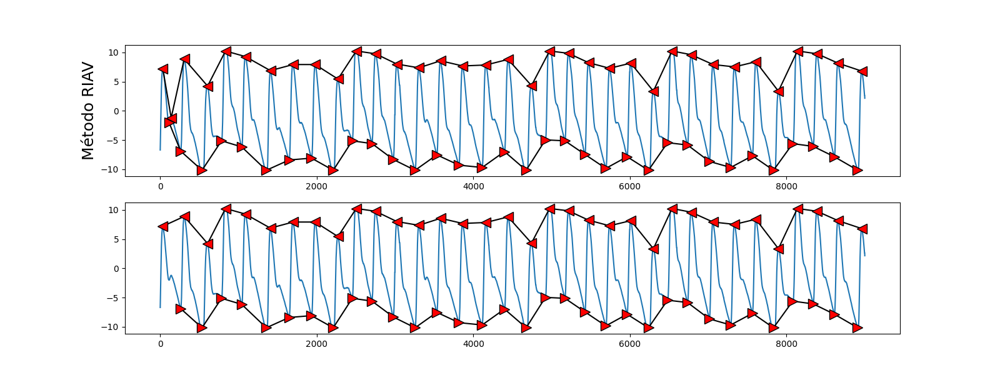

In [15]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1

xx =6

y2 = PPG_cap[xx][cp1:cp2]
p2, _ = find_peaks(y2, prominence=0.6)
v2, _ = find_peaks((y2*(-1)), prominence=0.6)


plt.figure(figsize=(16, 6))
plt.subplot(2, 1, 1)
plt.plot(y2)
plt.plot(p2, y2[p2], marker="<", color='black', markerfacecolor='r', markersize=12)
plt.plot(v2, y2[v2], marker=">", color='black', markerfacecolor='r', markersize=12)
print(len(p2))
print(len(v2))



plt.ylabel('Método RIAV', fontsize=18)

y2 = PPG_cap[xx][cp1:cp2]
p2, _ = find_peaks(y2, prominence=1)
v2, _ = find_peaks((y2*(-1)), prominence=1)
print(len(p2))
print(len(v2))

plt.subplot(2, 1, 2)
plt.plot(y2)
plt.plot(p2, y2[p2], marker="<", color='black', markerfacecolor='r', markersize=12)
plt.plot(v2, y2[v2], marker=">", color='black', markerfacecolor='r', markersize=12)



In [126]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1
T = 1 / fre_sinal
T_PPG = 1 / frequencia
for i in range(42):
    #VALOR CO2
    #sinal original com aumento das extremidades e remoção do sinal DC por media
    y0 = CO2_cap[i][cp1:cp2]
 
    # plt.figure(figsize=(16, 10))
    # plt.subplot(2, 1, 1)
    # plt.plot(sinal_CO2)

    yf3 = fft(y0)
    xf3 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
    yf3 = np.abs(yf3[0:N_JANELA//2])     

    fyy = xf3[5] - xf3[4]
    p1 = int(0.1/fyy)
    p2 = int(1/fyy)

    pos_y = yf3[p1:p2].argmax()
    val_x = xf3[pos_y+p1]
    print(val_x*60)

#     plt.subplot(2, 1, 2)
#     plt.plot(xf3[p1:p2],yf3[p1:p2])

#     plt.show()

17.999999999999996
27.999999999999993
9.999999999999998
35.99999999999999
21.999999999999996
11.999999999999996
9.999999999999998
27.999999999999993
9.999999999999998
11.999999999999996
23.999999999999993
19.999999999999996
17.999999999999996
11.999999999999996
9.999999999999998
39.99999999999999
17.999999999999996
9.999999999999998
11.999999999999996
13.999999999999996
17.999999999999996
11.999999999999996
9.999999999999998
13.999999999999996
15.999999999999996
9.999999999999998
9.999999999999998
9.999999999999998
9.999999999999998
7.999999999999998
11.999999999999996
5.999999999999998
9.999999999999998
17.999999999999996
9.999999999999998
9.999999999999998
9.999999999999998
15.999999999999996
13.999999999999996
27.999999999999993
13.999999999999996
9.999999999999998


19.999999999999996


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
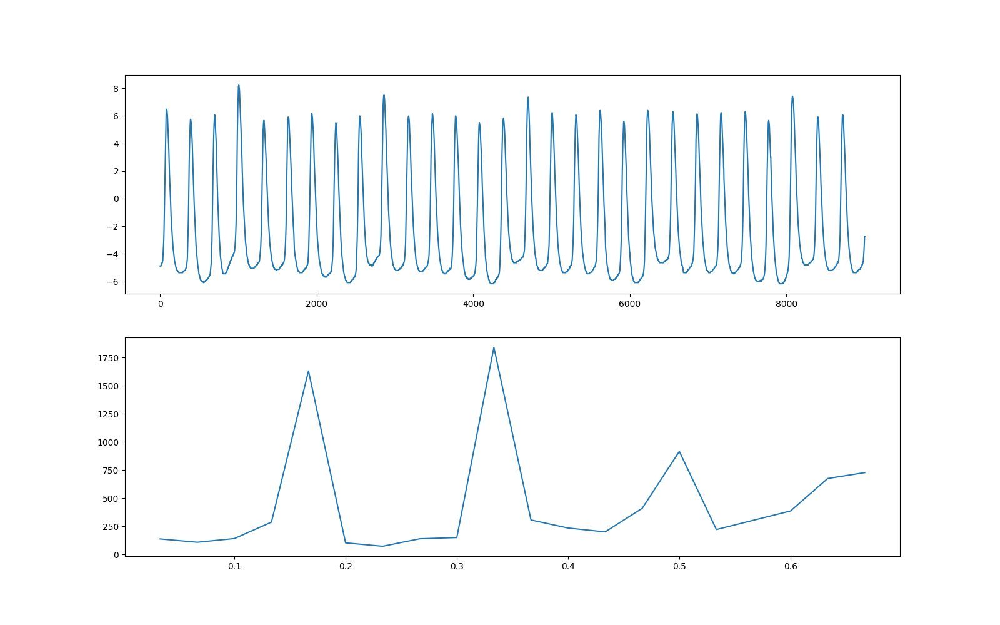

In [111]:
#VALOR CO2
#sinal original com aumento das extremidades e remoção do sinal DC por media
y0 = PPG_cap[27][cp1:cp2]



plt.figure(figsize=(16, 10))
plt.subplot(2, 1, 1)
plt.plot(y0)

yf3 = fft(y0)
xf3 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
yf3 = np.abs(yf3[0:N_JANELA//2])     

fyy = xf3[5] - xf3[4]
p1 = int(0.06/fyy)
p2 = int(0.7/fyy)

pos_y = yf3[p1:p2].argmax()
val_x = xf3[pos_y+p1]
print(val_x*60)

plt.subplot(2, 1, 2)
plt.plot(xf3[p1:p2],yf3[p1:p2])

plt.show()

In [30]:
p1

2

In [31]:
xf3

array([0.0000e+00, 2.0000e-02, 4.0000e-02, ..., 1.4994e+02, 1.4996e+02,
       1.4998e+02])

In [ ]:
FrMED = np.array(range(3))

In [ ]:
FrMED[0] = 25 
FrMED[1] = 3
FrMED[2] = 4

In [ ]:
orden = np.sort(FrMED) 

In [ ]:
FrMED

In [ ]:
orden

In [ ]:
np.mean(orden[1:3])

In [ ]:
FrPPG[i] = 0

In [ ]:
orden = np.sort(FrMED) 
difpu = abs(orden[0] - orden[2])
difpa = abs(orden[0] - orden[1])
difau = abs(orden[1] - orden[2])

if(difpu <= 3):
    FrPPG[i] = np.mean(orden)
elif (difpa <= 3):
    FrPPG[i] = np.mean(orden[0:2])
elif (difau <= 3):
    FrPPG[i] = np.mean(orden[1:3])
else:
    FrPPG[i] = FrMED[1]

In [ ]:
FrPPG[i]

9
20
[132. 124. 137. 129. 144. 129. 150. 129. 150. 120. 144. 129. 141. 126.
 147. 126. 139. 129. 146. 132. 147. 126. 138. 126. 141. 126. 147. 129.
 150. 130. 149. 124. 137. 133. 134. 129. 144. 129. 144. 126. 147. 132.
 147. 136. 131. 129. 171. 129. 150. 127. 164. 130. 149. 132. 147. 135.
 132. 127. 152. 126. 147. 127. 146. 129.] 132.5
31
Wall time: 220 ms


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
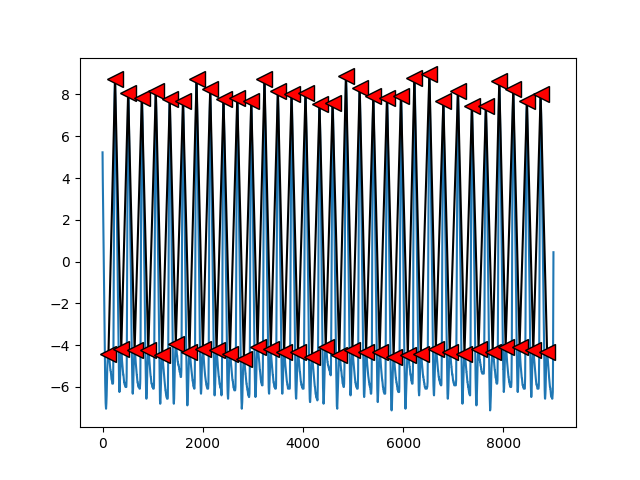

In [85]:
%%time
%matplotlib widget
import matplotlib.pyplot as plt
cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1
for i in range(num_arquivos):
    
    y2 = PPG_cap[i][cp1:cp2]
    val_x_peaks_ac, _ = find_peaks(y2, prominence=1)
    fm_y = np.zeros(len(val_x_peaks_ac)-1)
    for z in range(len(val_x_peaks_ac)-1):
        fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
    z = 0
    while(z < len(fm_y)):
        if(abs(fm_y[z] - np.median(fm_y))>(np.median(fm_y)*0.30)):
            afonso = "sinal ruim"
            print(i)
            break
        else:
            afonso = "sinal bom"
            z = z + 1
    #print(np.median(fm_y)*1.3,i)
    #print(fm_y)
    if(i == 21):
        print(fm_y,np.median(fm_y))
        plt.plot(y2)
        plt.plot(val_x_peaks_ac, y2[val_x_peaks_ac], marker="<", color='black', markerfacecolor='r', markersize=12)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
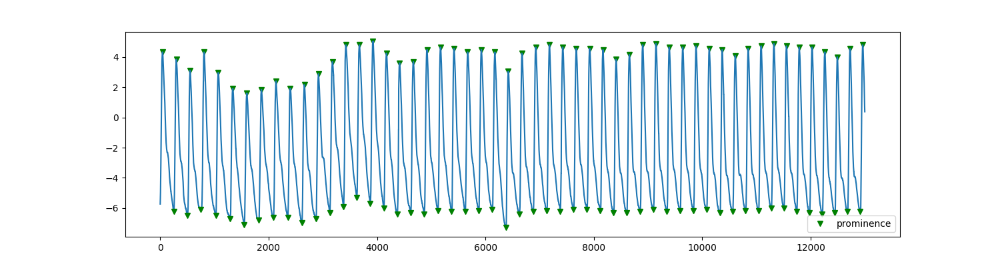

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
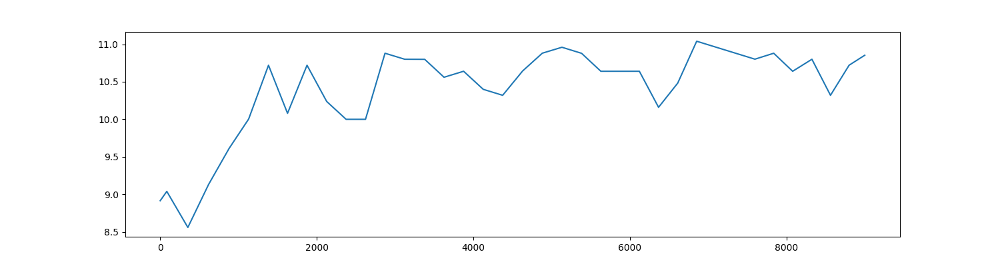

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
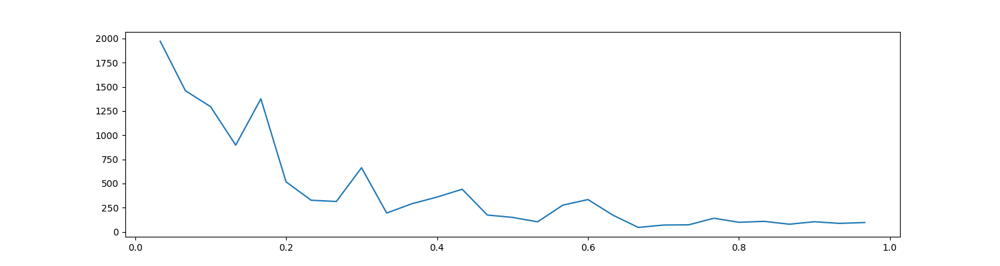

In [125]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1

#sinal original com aumento das extremidades e remoção do sinal DC por media
sinal_original = PPG_cap[16][cp1-2000:cp2+2000]
sinal_ac = sinal_original
#pegando os picos e vales
val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
# ###############################LINHA DE BASE            
# l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
# pedro = np.zeros(len(sinal_original))
# for k in range(len(sinal_original)):
#     pedro[k] = l_b(k)
# y0 = pedro[2000:(len(sinal_original)-2000)]
# ###############################LINHA DE BASE

##############################AMPLITUDE    
#quantidade de picos menores/igual e primeiro pico começa antes do vale
if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
    pedro = np.zeros(len(val_x_peaks_ac)-1)
    for z in range(len(pedro)-1):
        pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#quantidade de picos menores/igual e primeiro pico começa depois do vale
elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
    pedro = np.zeros(len(val_x_peaks_ac))
    for z in range(len(pedro)):
        pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#quantidade de vales menores/igual e primeiro pico começa antes do vale
elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
    pedro = np.zeros(len(vales_x)-1)
    for z in range(len(pedro)-1):
        pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#quantidade de vales menores/igual e primeiro pico começa depois do vale
elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
    pedro = np.zeros(len(vales_x))
    for z in range(len(pedro)):
        pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

else:
    www = www + 1
    print("condiçao maluca ver", inicio, fim, www)


s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
maria = np.zeros(len(sinal_original))
for aux3 in range(len(sinal_original)):
    maria[aux3] = s_a(aux3)    
y0 = maria[2000:(len(sinal_original)-2000)]
##############################AMPLITUDE
        
        

plt.figure(figsize=(15, 4))
plt.plot(val_x_peaks_ac, sinal_ac[val_x_peaks_ac], "vg"); plt.plot(sinal_ac); plt.legend(['prominence'])
plt.plot(vales_x, sinal_ac[vales_x], "vg")
plt.show()

plt.figure(figsize=(15, 4))
plt.plot(y0)
plt.show()


T_PPG = 1/frequencia
N_JANELA = len(y0)
yf0 = fft(y0)
xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
yf0 = np.abs(yf0[0:N_JANELA//2])

plt.figure(figsize=(15, 4))
plt.plot(xf0[1:30],yf0[1:30])


plt.show()

In [ ]:
%matplotlib widget
import matplotlib.pyplot as plt 
T_PPG = 1/frequencia
N_JANELA = len(ROGERIN)
yf0 = fft(ROGERIN)
xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
yf0 = np.abs(yf0[0:N_JANELA//2])

plt.figure(figsize=(16, 5))
plt.plot(xf0[1:],yf0[1:])

plt.xlabel('Frequência(Hz)', fontsize=18)
plt.ylabel('FFT', fontsize=18)

plt.show()

In [ ]:
%%time
resultado33 = np.empty((num_arquivos,5*janela_tempo))
www = 0

for kk in range(janela_tempo):
    ######################################################################### FFT ##########################################################################################################################
    # sample spacing
    T = 1 / fre_sinal
    T_PPG = 1 / frequencia

    Xfft_PPG = np.empty((num_arquivos, int(N_JANELA/2)))
    Yfft_PPG = np.empty((num_arquivos, int(N_JANELA/2)))
    Xfft_CO2 = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    Yfft_CO2 = np.empty((num_arquivos, int(N_JANELA_NORMAL/2)))
    resultado = np.empty((num_arquivos,6))
    sinal_ppg = np.empty((num_arquivos,N_JANELA))

    FrPPG = np.array(range(num_arquivos))
    FrCO2 = np.array(range(num_arquivos))
    FrREF = np.array(range(num_arquivos))
    Erro_fft = np.array(range(num_arquivos))
    Erro_medido = np.array(range(num_arquivos))

    Y = np.linspace(1, 42, num_arquivos)
    for i in range(num_arquivos):
        
        cp1 = (kk * frequencia) + (frequencia * inicio) 
        cp2 = N_JANELA + cp1
        
        #################################################################################fft
        #y0 = PPG_cap[i][cp1:cp2]
        #################################################################################fft
        
        
        
        
        #################################################################################linha de base/amplitude/frequencia      
        # #sinal original com aumento das extremidades e remoção do sinal DC por media
        # sinal_original = PPG_cap[i][cp1-2000:cp2+2000]
        # sinal_ac = sinal_original - np.mean(sinal_original)
        # #pegando os picos e vales
        # val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
        # vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
        # #Diferença no numero de vales e picos é menor q 2
        # # if( abs(len(val_x_peaks_ac) - len(vales_x)) < 3):
            
#         ###############################AMPLITUDE    
#         #quantidade de picos menores/igual e primeiro pico começa antes do vale
#         if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#             pedro = np.zeros(len(val_x_peaks_ac)-1)
#             for z in range(len(pedro)-1):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#         #quantidade de picos menores/igual e primeiro pico começa depois do vale
#         elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#             pedro = np.zeros(len(val_x_peaks_ac))
#             for z in range(len(pedro)):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#         #quantidade de vales menores/igual e primeiro pico começa antes do vale
#         elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#             pedro = np.zeros(len(vales_x)-1)
#             for z in range(len(pedro)-1):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#         #quantidade de vales menores/igual e primeiro pico começa depois do vale
#         elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#             pedro = np.zeros(len(vales_x))
#             for z in range(len(pedro)):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#         else:
#             www = www + 1
#             print("condiçao maluca ver", inicio, fim, www)


#         s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
#         maria = np.zeros(len(sinal_original))
#         for aux3 in range(len(sinal_original)):
#             maria[aux3] = s_a(aux3)    
#         y0 = maria[2000:(len(sinal_original)-2000)]
        ###############################AMPLITUDE
            
        # ###############################LINHA DE BASE            
        # l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
        # pedro = np.zeros(len(sinal_original))
        # for k in range(len(sinal_original)):
        #     pedro[k] = l_b(k)
        # y0 = pedro[2000:(len(sinal_original)-2000)]
        # ###############################LINHA DE BASE

        # ###############################FREQUENCIA
        # fm_y = np.zeros(len(val_x_peaks_ac)-1)
        # for z in range(len(val_x_peaks_ac)-1):
        #     fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
        # fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
        # s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
        # joao = np.zeros(len(sinal_original))
        # for k in range(len(sinal_original)):
        #     joao[k] = s_f(k)
        # y0 = joao[2000:(len(sinal_original)-2000)]
        # ###############################FREQUENCIA            
            
        # else:
        #     www = www + 1
        #     print("picos e vales diferentes de 1!", cp1, cp2, www, i)
        #     tt = np.linspace(0, janela, N_JANELA, endpoint=False)
        #     y0 = np.sin(0.83*2*np.pi*tt)
        
        #############EMD
        order = 5       
        cutoff = 3
        data = PPG_cap[i][cp1:cp2] - np.mean(PPG_cap[i][cp1:cp2])
        ROGERIN = butter_lowpass_filter(data, cutoff, frequencia, order)
        time = np.linspace(0, 1, len(ROGERIN))
        emd1 = EMD()
        IMF = emd1.emd(ROGERIN, time)

        #y0 = IMF[0] #IMF1
        #y0 = IMF[1] #IMF2
        #y0 = IMF[2] #IMF3
        y0 = IMF[3] #IMF4
        #############EMD
        
        
        sinal_ppg[i] = y0
        yf0 = fft(y0)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])
        Xfft_PPG[i] = xf0
        Yfft_PPG[i] = yf0

        cp3 = (kk * fre_sinal) + (fre_sinal * inicio)
        cp4 = N_JANELA_NORMAL + cp3
        y1 = CO2_cap[i][cp3:cp4]
        yf1 = fft(y1)
        x1 = fftfreq(N_JANELA_NORMAL, T)[:N_JANELA_NORMAL//2]
        y1 = np.abs(yf1[0:N_JANELA_NORMAL//2])
        Xfft_CO2[i] = x1
        Yfft_CO2[i] = y1

        fyy = Xfft_PPG[i][5] - Xfft_PPG[i][4]
        p1 = int(0.15/fyy)
        p2 = int(0.83/fyy)
        
        fy = Xfft_CO2[i][5] - Xfft_CO2[i][4]
        p3 = int(0.15/fy)
        p4 = int(0.83/fy)     

        pos_y = Yfft_PPG[i][p1:p2].argmax()
        val_x = Xfft_PPG[i][pos_y+p1]
        FrPPG[i] = val_x*60

        pos_y = Yfft_CO2[i][p3:p4].argmax()
        val_x = Xfft_CO2[i][pos_y+p3]
        FrCO2[i] = val_x*60

        data = np.where(rpm_cap[i] != (find_nearest(rpm_cap[i], 0)))
        y = data[0].size    
        y = y - 1

        y = data[0][y]
        x = data[0][0]
        FrREF[i] = np.mean(rpm_cap[i][x:y])

        Erro_fft[i] = FrCO2[i] - FrPPG[i]

        Erro_medido[i] = FrREF[i] - FrPPG[i]
        Y[i] = i + 1
        resultado[i] = [ Y[i], FrPPG[i], FrCO2[i], FrREF[i], Erro_fft[i], Erro_medido[i] ] 
    print(cp1,cp2)
    print(cp3,cp4)
    ########################################################################## Calcula raiz do erro medio quadradico ###########################################################################################

    resultado1 = np.empty((5,2))

    RMSE_fftCO2 = rmse(FrPPG, FrCO2)
    RMSE_FrREF = rmse(FrPPG, FrREF)

    percentual0_fftCO2 = ((np.count_nonzero((Erro_fft==0)))*100)/Erro_fft.size
    percentual1_fftCO2 = ((np.count_nonzero((Erro_fft<1)&(Erro_fft>-1)))*100)/Erro_fft.size
    percentual2_fftCO2 = ((np.count_nonzero((Erro_fft<2)&(Erro_fft>-2)))*100)/Erro_fft.size
    percentual3_fftCO2 = ((np.count_nonzero((Erro_fft<3)&(Erro_fft>-3)))*100)/Erro_fft.size

    percentual0_FrREF = (np.count_nonzero((Erro_medido==0))*100)/Erro_medido.size
    percentual1_FrREF = ((np.count_nonzero((Erro_medido<1)&(Erro_medido>-1)))*100)/Erro_medido.size
    percentual2_FrREF = ((np.count_nonzero((Erro_medido<2)&(Erro_medido>-2)))*100)/Erro_medido.size
    percentual3_FrREF = ((np.count_nonzero((Erro_medido<3)&(Erro_medido>-3)))*100)/Erro_medido.size

    resultado1[0] = [round(RMSE_fftCO2,1),round(RMSE_FrREF,1)]
    resultado1[1] = [round(percentual0_fftCO2,1),round(percentual0_FrREF,1)]
    resultado1[2] = [round(percentual1_fftCO2,1),round(percentual1_FrREF,1)]
    resultado1[3] = [round(percentual2_fftCO2,1),round(percentual2_FrREF,1)]
    resultado1[4] = [round(percentual3_fftCO2,1),round(percentual3_FrREF,1)]

    ###################################################################################### plot ################################################################################################################

    linhas = 5

    # Create figure
    fig = make_subplots(rows=linhas, cols=1)
    # Add all traces of pacient
    for i in range(num_arquivos):
        fig.add_scatter(y=sinal_ppg[i],
                        row=1, col=1, visible=False,
                        showlegend = False,
                        name = "(x,y)",
                        marker_color="red")
    for i in range(num_arquivos):
        fig.add_scatter(y=CO2_cap[i][cp3:cp4],
                        row=2, col=1, visible=False,
                        showlegend = False,
                        name = "(x,y)",
                        marker_color="black")
    for i in range(num_arquivos):
        fig.add_scatter(x=rpms_cap[i], y=rpm_cap[i],
                        row=3, col=1, visible=False,
                        showlegend = False,
                         mode="markers",
                        name = "(x,y)",
                        marker_color="green")
    for i in range(num_arquivos):
        Y=Yfft_PPG[i] * 2/N_JANELA
        fig.add_scatter(x=Xfft_PPG[i][p1:p2], y=Y[p1:p2],
                        row=4, col=1, visible=False,
                        showlegend = False,
                        name = "(x,y)",
                        marker_color="red")
    for i in range(num_arquivos):
        Y=Yfft_CO2[i] * 2/N_JANELA_NORMAL
        fig.add_scatter(x=Xfft_CO2[i][p3:p4] , y=Y[p3:p4],
                        row=5, col=1, visible=False,
                        showlegend = False,
                        name = "(x,y)",
                        marker_color="black")

    # Make 10th trace visible
    for i in range(linhas):
        fig.data[i*num_arquivos].visible = True


    # Create and add slider
    steps = []
    for i in range(num_arquivos):
        step = dict(
            method="update",
            args=[{"visible": [False] * len(fig.data)}],  # layout attribute
        )
        for k in range(linhas):
            step["args"][0]["visible"][i+(k*num_arquivos)] = True  # Toggle i'th trace to "visible"
        steps.append(step)

    sliders = [dict(
        steps=steps
    )]

    # Update xaxis properties
    fig.update_xaxes(title_text="Amostras (u)", row=2, col=1)
    fig.update_xaxes(title_text="Tempo (s)", row=3, col=1)
    fig.update_xaxes(title_text="frequencia (Hz)", row=5, col=1)
    fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

    # Update yaxis properties
    fig.update_yaxes(title_text="PPG", row=1, col=1)
    fig.update_yaxes(title_text="CO2", row=2, col=1)
    fig.update_yaxes(range = [1,50],title_text="rpm", row=3, col=1)
    fig.update_yaxes(title_text="FFT-PPG", row=4, col=1)
    fig.update_yaxes(title_text="FFT-CO2", row=5, col=1)
    fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

    fig.update_layout(
        title="Capnobase Sinal:",
        sliders=sliders,
        plot_bgcolor='rgba(0,0,0,0)',
        height=1000
    )

    # Edit slider labels
    fig['layout']['sliders'][0]['currentvalue']['prefix']='Paciente: '
    for i in range(num_arquivos):
        fig['layout']['sliders'][0]['steps'][i]['label']=i+1


    #fig.show()
    plotly.offline.plot(fig, filename="De"+str(inicio+kk)+"ate"+str(inicio+janela+kk)+'.html',auto_open=False)


    ######################################################################################## salva excel #######################################################################################################

#     data_array = resultado[:,1:]
#     row_indices = resultado[:,0]
#     column_names = ['PPG','CO2', 'RR', 'CO2-PPG', 'RR-PPG']


#     data_df = pd.DataFrame(data_array, columns=column_names, index=row_indices)

#     book = load_workbook('erro.xlsx')
#     writer = pd.ExcelWriter('erro.xlsx', engine = 'openpyxl', mode='a')
#     writer.book = book
#     data_df.to_excel(writer, sheet_name="De"+str(inicio+kk)+"ate"+str(inicio+janela+kk))
#     writer.close()

    data_array = resultado1
    row_indices = ['RMSE','PERCENTUAL-0rpm','PERCENTUAL-1rpm','PERCENTUAL-2rpm','PERCENTUAL-3rpm']
    column_names = ['CO2-PPG', 'RR-PPG']


    data_df = pd.DataFrame(data_array, columns=column_names, index=row_indices)

    book = load_workbook('precisao.xlsx')
    writer = pd.ExcelWriter('precisao.xlsx', engine = 'openpyxl', mode='a')
    writer.book = book
    data_df.to_excel(writer, sheet_name="De"+str(inicio+kk)+"ate"+str(inicio+janela+kk))
    writer.close()
    
    resultado33[0:,(kk*5):(5+(kk*5))] = resultado[:,1:]
    
    print(kk)
    
data_array = resultado33
row_indices = resultado[:,0]
data_df = pd.DataFrame(data_array, index=row_indices)

book = load_workbook('erro.xlsx')
writer = pd.ExcelWriter('erro.xlsx', engine = 'openpyxl', mode='a')
writer.book = book
data_df.to_excel(writer, sheet_name="TUDO")
writer.close()

In [ ]:
%%time
%matplotlib widget
import matplotlib.pyplot as plt 
contador3 = 0
contador4 = 0
contador5 = 0
 
FrPPG = np.array(range(janela_tempo))
FrPPG1 = np.array(range(janela_tempo))
FrPPG2 = np.array(range(janela_tempo))
FrPPG3 = np.array(range(janela_tempo))
FrPPG_posiçao2 = np.array(range(janela_tempo))
FrPPG1_posiçao2 = np.array(range(janela_tempo))
FrPPG2_posiçao2 = np.array(range(janela_tempo))
FrPPG3_posiçao2 = np.array(range(janela_tempo))
FrIMP = np.array(range(janela_tempo))
FrREF = np.array(range(janela_tempo))
resultado = np.empty((janela_tempo,9))

T = 1 / fre_sinal
T_PPG = 1 / frequencia
for i in range(num_arquivos):
    print(i)
    for kk in range(janela_tempo):
        cp1 = (kk * frequencia) + (frequencia * inicio) 
        cp2 = N_JANELA + cp1

        #sinal original com aumento das extremidades e remoção do sinal DC por media
        sinal_original = PPG_cap[i][cp1-2000:cp2+2000]
        sinal_ac = sinal_original - np.mean(sinal_original)
        y0 = sinal_ac
        #pegando os picos e vales
        val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
        vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
        #Diferença no numero de vales e picos é menor q 2
        
        ###############################AMPLITUDE    
        #quantidade de picos menores/igual e primeiro pico começa antes do vale
        if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
            pedro = np.zeros(len(val_x_peaks_ac)-1)
            for z in range(len(pedro)-1):
                pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

        #quantidade de picos menores/igual e primeiro pico começa depois do vale
        elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
            pedro = np.zeros(len(val_x_peaks_ac))
            for z in range(len(pedro)):
                pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

        #quantidade de vales menores/igual e primeiro pico começa antes do vale
        elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
            pedro = np.zeros(len(vales_x)-1)
            for z in range(len(pedro)-1):
                pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

        #quantidade de vales menores/igual e primeiro pico começa depois do vale
        elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
            pedro = np.zeros(len(vales_x))
            for z in range(len(pedro)):
                pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

        else:
            print("condiçao maluca ver")

        
        s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
        maria = np.zeros(len(sinal_original))
        for aux3 in range(len(sinal_original)):
            maria[aux3] = s_a(aux3)    
        y1 = maria[2000:(len(sinal_original)-2000)]
        ###############################AMPLITUDE
       
        ###############################LINHA DE BASE            
        l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
        pedro = np.zeros(len(sinal_original))
        for k in range(len(sinal_original)):
            pedro[k] = l_b(k)
        y11 = pedro[2000:(len(sinal_original)-2000)]
        ###############################LINHA DE BASE
        
        ###############################FREQUENCIA
        fm_y = np.zeros(len(val_x_peaks_ac)-1)
        for z in range(len(val_x_peaks_ac)-1):
            fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
        fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
        s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
        joao = np.zeros(len(sinal_original))
        for k in range(len(sinal_original)):
            joao[k] = s_f(k)
        y111 = joao[2000:(len(sinal_original)-2000)]
        ###############################FREQUENCIA 
        
        yf0 = fft(y1)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])

        fy = xf0[5] - xf0[4]
        p1 = int(0.15/fy)
        p2 = int(0.83/fy)     

        pos_y = yf0[p1:p2].argmax()
        val_x = xf0[pos_y+p1]
        #Valor respiração medido
        FrPPG[kk] = val_x*60
        
        #teste louco
        ww = -np.sort(-yf0[p1:p2])
        FrPPG_posiçao2[kk] = ww[1]*60
        
        #teste louco

        yf0 = fft(y11)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])

        fy = xf0[5] - xf0[4]
        p1 = int(0.15/fy)
        p2 = int(0.83/fy)     

        pos_y = yf0[p1:p2].argmax()
        val_x = xf0[pos_y+p1]
        #Valor respiração medido
        FrPPG1[kk] = val_x*60
        
        #teste louco
        ww = -np.sort(-yf0[p1:p2])
        FrPPG1_posiçao2[kk] = ww[1]*60
        
        #teste louco

        yf0 = fft(y111)
        xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
        yf0 = np.abs(yf0[0:N_JANELA//2])

        fy = xf0[5] - xf0[4]
        p1 = int(0.15/fy)
        p2 = int(0.83/fy)     

        pos_y = yf0[p1:p2].argmax()
        val_x = xf0[pos_y+p1]
        #Valor respiração medido
        FrPPG2[kk] = val_x*60
        
        #teste louco
        ww = -np.sort(-yf0[p1:p2])
        FrPPG2_posiçao2[kk] = ww[1]*60
        
        #teste louco
        
        soma = (FrPPG[kk] + FrPPG1[kk] + FrPPG2[kk])/3
        soma1 = abs(soma - FrPPG[kk])
        soma2 = abs(soma - FrPPG1[kk])
        soma3 = abs(soma - FrPPG2[kk])
        
        somalouca = (FrPPG_posiçao2[kk] + FrPPG1_posiçao2[kk] + FrPPG2_posiçao2[kk])/3
        somalouca1 = abs(somalouca - FrPPG_posiçao2[kk])
        somalouca2 = abs(somalouca - FrPPG1_posiçao2[kk])
        somalouca3 = abs(somalouca - FrPPG2_posiçao2[kk])
        
        if( soma1 <= 3 and soma2 <= 3 and soma3 <= 3 ):
            FrPPG3[kk] = soma
            contador3 = contador3 + 1
            
        elif (somalouca1 <= 3 and somalouca2 <= 3 and somalouca3 <= 3 ):
            FrPPG3_posiçao2[kk] = somalouca
            contador5 = contador5 + 1
            
        
        else:
            FrPPG[kk] = 3
            FrPPG1[kk] = 3
            FrPPG2[kk] = 3
            FrPPG3[kk] = 3
            FrIMP[kk] = 3
            FrREF[kk] = 3
            FrPPG3_posiçao2[kk] = 3
        
        cp3 = (kk * fre_sinal) + (fre_sinal * inicio)
        cp4 = N_JANELA_NORMAL + cp3
        y1 = CO2_cap[i][cp3:cp4]
        yf1 = fft(y1)
        x1 = fftfreq(N_JANELA_NORMAL, T)[:N_JANELA_NORMAL//2]
        y1 = np.abs(yf1[0:N_JANELA_NORMAL//2])
        
        fy = x1[5] - x1[4]
        p3 = int(0.15/fy)
        p4 = int(0.83/fy)     

        pos_y = y1[p3:p4].argmax()
        val_x = x1[pos_y+p3]
        #Valor respiração impedancia
        FrIMP[kk] = val_x*60
        
        #Valor respiração normal
        data = np.where(rpm_cap[i] != (find_nearest(rpm_cap[i], 0)))
        y = data[0].size    
        y = y - 1

        y = data[0][y]
        x = data[0][0]
        FrREF[kk] = np.mean(rpm_cap[i][x:y])    

        ayalon = abs(FrPPG3[kk] - FrREF[kk])
        
        if(ayalon<=3):
            contador4 = contador4 + 1
        resultado[kk] = [ cp1, cp2, FrPPG[kk], FrPPG1[kk], FrPPG2[kk], FrPPG3[kk], FrIMP[kk], FrREF[kk], FrPPG3_posiçao2[kk] ]
        
    data_array = resultado
    column_names = ['Inicio(u)', 'Fim(u)', 'MedidoAM(rpm)', 'MedidoLB(rpm)', 'MedidoFR(rpm)', 'Média(rpm)', 'Impedancia(rpm)', 'Referencia(rpm)', 'Média2(rpm)']
    data_df = pd.DataFrame(data_array, columns=column_names)
    
    book = load_workbook('erro.xlsx')
    writer = pd.ExcelWriter('erro.xlsx', engine = 'openpyxl', mode='a')
    writer.book = book
    data_df.to_excel(writer, sheet_name="TUDO")
    writer.close()

In [ ]:
i=0
import matplotlib.pyplot as plt 
contador3 = 0
contador4 = 0
contador5 = 0
 
FrPPG = np.array(range(janela_tempo))
FrPPG1 = np.array(range(janela_tempo))
FrPPG2 = np.array(range(janela_tempo))
FrPPG3 = np.array(range(janela_tempo))
FrPPG_posiçao2 = np.array(range(janela_tempo))
FrPPG1_posiçao2 = np.array(range(janela_tempo))
FrPPG2_posiçao2 = np.array(range(janela_tempo))
FrPPG3_posiçao2 = np.array(range(janela_tempo))
FrIMP = np.array(range(janela_tempo))
FrREF = np.array(range(janela_tempo))
resultado = np.empty((janela_tempo,9))



for kk in range(janela_tempo):
    cp1 = (kk * frequencia) + (frequencia * inicio) 
    cp2 = N_JANELA + cp1
    print(kk)
    #sinal original com aumento das extremidades e remoção do sinal DC por media
    sinal_original = PPG_cap[i][cp1-2000:cp2+2000]
    sinal_ac = sinal_original - np.mean(sinal_original)
    y0 = sinal_ac
    #pegando os picos e vales
    val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
    vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
    #Diferença no numero de vales e picos é menor q 2

    ###############################AMPLITUDE    
    #quantidade de picos menores/igual e primeiro pico começa antes do vale
    if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
        pedro = np.zeros(len(val_x_peaks_ac)-1)
        for z in range(len(pedro)-1):
            pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

    #quantidade de picos menores/igual e primeiro pico começa depois do vale
    elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
        pedro = np.zeros(len(val_x_peaks_ac))
        for z in range(len(pedro)):
            pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

    #quantidade de vales menores/igual e primeiro pico começa antes do vale
    elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
        pedro = np.zeros(len(vales_x)-1)
        for z in range(len(pedro)-1):
            pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

    #quantidade de vales menores/igual e primeiro pico começa depois do vale
    elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
        pedro = np.zeros(len(vales_x))
        for z in range(len(pedro)):
            pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

    else:
        print("condiçao maluca ver")


    s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
    maria = np.zeros(len(sinal_original))
    for aux3 in range(len(sinal_original)):
        maria[aux3] = s_a(aux3)    
    y1 = maria[2000:(len(sinal_original)-2000)]
    ###############################AMPLITUDE

    ###############################LINHA DE BASE            
    l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
    pedro = np.zeros(len(sinal_original))
    for k in range(len(sinal_original)):
        pedro[k] = l_b(k)
    y11 = pedro[2000:(len(sinal_original)-2000)]
    ###############################LINHA DE BASE

    ###############################FREQUENCIA
    fm_y = np.zeros(len(val_x_peaks_ac)-1)
    for z in range(len(val_x_peaks_ac)-1):
        fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
    fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
    s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
    joao = np.zeros(len(sinal_original))
    for k in range(len(sinal_original)):
        joao[k] = s_f(k)
    y111 = joao[2000:(len(sinal_original)-2000)]
    ###############################FREQUENCIA 

    yf0 = fft(y1)
    xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
    yf0 = np.abs(yf0[0:N_JANELA//2])

    fy = xf0[5] - xf0[4]
    p1 = int(0.15/fy)
    p2 = int(0.83/fy)     

    pos_y = yf0[p1:p2].argmax()
    val_x = xf0[pos_y+p1]
    #Valor respiração medido
    FrPPG[kk] = val_x*60

    #teste louco
    ww = -np.sort(-yf0[p1:p2])
    FrPPG_posiçao2[kk] = ww[1]*60

    #teste louco

    yf0 = fft(y11)
    xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
    yf0 = np.abs(yf0[0:N_JANELA//2])

    fy = xf0[5] - xf0[4]
    p1 = int(0.15/fy)
    p2 = int(0.83/fy)     

    pos_y = yf0[p1:p2].argmax()
    val_x = xf0[pos_y+p1]
    #Valor respiração medido
    FrPPG1[kk] = val_x*60

    #teste louco
    ww = -np.sort(-yf0[p1:p2])
    FrPPG1_posiçao2[kk] = ww[1]*60

    #teste louco

    yf0 = fft(y111)
    xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
    yf0 = np.abs(yf0[0:N_JANELA//2])

    fy = xf0[5] - xf0[4]
    p1 = int(0.15/fy)
    p2 = int(0.83/fy)     

    pos_y = yf0[p1:p2].argmax()
    val_x = xf0[pos_y+p1]
    #Valor respiração medido
    FrPPG2[kk] = val_x*60

    #teste louco
    ww = -np.sort(-yf0[p1:p2])
    FrPPG2_posiçao2[kk] = ww[1]*60

    #teste louco

    soma = (FrPPG[kk] + FrPPG1[kk] + FrPPG2[kk])/3
    soma1 = abs(soma - FrPPG[kk])
    soma2 = abs(soma - FrPPG1[kk])
    soma3 = abs(soma - FrPPG2[kk])

    somalouca = (FrPPG_posiçao2[kk] + FrPPG1_posiçao2[kk] + FrPPG2_posiçao2[kk])/3
    somalouca1 = abs(somalouca - FrPPG_posiçao2[kk])
    somalouca2 = abs(somalouca - FrPPG1_posiçao2[kk])
    somalouca3 = abs(somalouca - FrPPG2_posiçao2[kk])

    if( soma1 <= 3 and soma2 <= 3 and soma3 <= 3 ):
        FrPPG3[kk] = soma
        contador3 = contador3 + 1

    elif (somalouca1 <= 3 and somalouca2 <= 3 and somalouca3 <= 3 ):
        FrPPG3_posiçao2[kk] = somalouca
        contador5 = contador5 + 1


    else:
        FrPPG[kk] = 3
        FrPPG1[kk] = 3
        FrPPG2[kk] = 3
        FrPPG3[kk] = 3
        FrIMP[kk] = 3
        FrREF[kk] = 3
        FrPPG3_posiçao2[kk] = 3

    cp3 = (kk * fre_sinal) + (fre_sinal * inicio)
    cp4 = N_JANELA_NORMAL + cp3
    y1 = CO2_cap[i][cp3:cp4]
    yf1 = fft(y1)
    x1 = fftfreq(N_JANELA_NORMAL, T)[:N_JANELA_NORMAL//2]
    y1 = np.abs(yf1[0:N_JANELA_NORMAL//2])

    fy = x1[5] - x1[4]
    p3 = int(0.15/fy)
    p4 = int(0.83/fy)     

    pos_y = y1[p3:p4].argmax()
    val_x = x1[pos_y+p3]
    #Valor respiração impedancia
    FrIMP[kk] = val_x*60

    #Valor respiração normal
    data = np.where(rpm_cap[i] != (find_nearest(rpm_cap[i], 0)))
    y = data[0].size    
    y = y - 1

    y = data[0][y]
    x = data[0][0]
    FrREF[kk] = np.mean(rpm_cap[i][x:y])    

    ayalon = abs(FrPPG3[kk] - FrREF[kk])

    if(ayalon<=3):
        contador4 = contador4 + 1
    resultado[kk] = [ cp1, cp2, FrPPG[kk], FrPPG1[kk], FrPPG2[kk], FrPPG3[kk], FrIMP[kk], FrREF[kk], FrPPG3_posiçao2[kk] ]
    print(cp1, cp2, FrPPG[kk], FrPPG1[kk], FrPPG2[kk], FrPPG3[kk], FrIMP[kk], FrREF[kk], FrPPG3_posiçao2[kk])

In [ ]:
#Valor respiração normal
data = np.where(rpm_cap[0] != (find_nearest(rpm_cap[0], 0)))
y = data[0].size    
y = y - 1

y = data[0][y]
x = data[0][0]
np.mean(rpm_cap[0][x:y])    

In [ ]:
x

In [ ]:
y

In [ ]:
rpm_cap[0][480]

In [ ]:
linhas = 1

# Create figure
fig = make_subplots(rows=linhas, cols=1)
# Add all traces of pacient
for i in range(num_arquivos):
    fig.add_scatter(y=rpm_cap[i],
                    row=1, col=1, visible=False,
                    showlegend = False,
                    name = "(x,y)",
                    marker_color="red")

# Make 10th trace visible
for i in range(linhas):
    fig.data[i*num_arquivos].visible = True


# Create and add slider
steps = []
for i in range(num_arquivos):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],  # layout attribute
    )
    for k in range(linhas):
        step["args"][0]["visible"][i+(k*num_arquivos)] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    steps=steps
)]

# Update xaxis properties
fig.update_xaxes(title_text="Amostras (u)", row=1, col=1)
fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

# Update yaxis properties
fig.update_yaxes(title_text="PPG", row=1, col=1)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)

fig.update_layout(
    title="Capnobase Sinal:",
    sliders=sliders,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

# Edit slider labels
fig['layout']['sliders'][0]['currentvalue']['prefix']='Paciente: '
for i in range(num_arquivos):
    fig['layout']['sliders'][0]['steps'][i]['label']=i+1
fig.show()

In [ ]:
%matplotlib widget
import numpy as np
import matplotlib.pyplot as plt 
from scipy.signal import find_peaks

x = PPG_cap[1]
peaks, _ = find_peaks(x, distance=20)
peaks2, _ = find_peaks(x, prominence=1, distance=33)      # BEST!
peaks3, _ = find_peaks(x, width=20)
peaks4, _ = find_peaks(x, threshold=0.4)     # Required vertical distance to its direct neighbouring samples, pretty useless

plt.plot(peaks2, x[peaks2], "ob"); plt.plot(x); plt.legend(['prominence'])

plt.show()

In [ ]:
N_JANELA

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
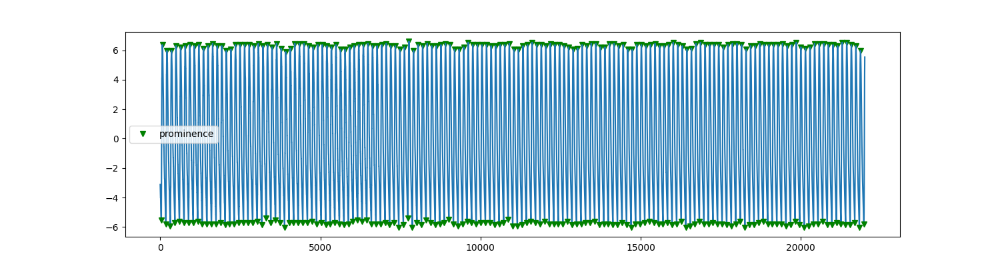

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
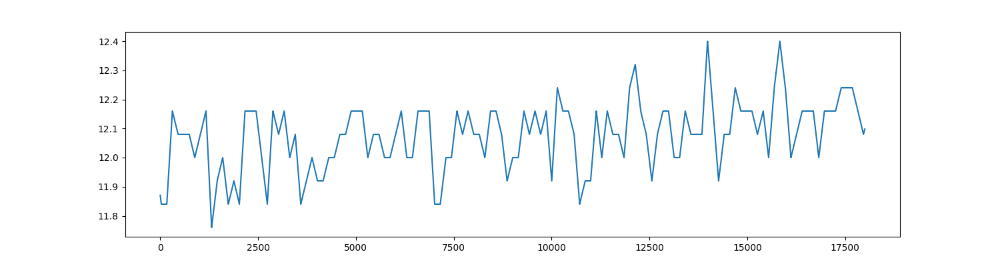

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
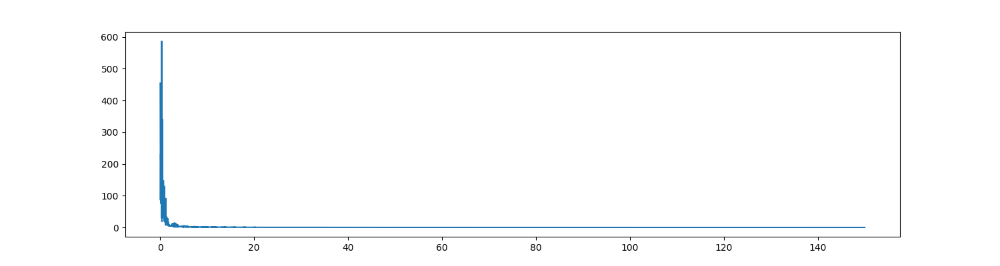

In [24]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1

#sinal original com aumento das extremidades e remoção do sinal DC por media
sinal_original = PPG_cap[2][cp1-2000:cp2+2000]
sinal_ac = sinal_original - np.mean(sinal_original)
#pegando os picos e vales
val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
# ###############################LINHA DE BASE            
# l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
# pedro = np.zeros(len(sinal_original))
# for k in range(len(sinal_original)):
#     pedro[k] = l_b(k)
# y0 = pedro[2000:(len(sinal_original)-2000)]
# ###############################LINHA DE BASE

##############################AMPLITUDE    
#quantidade de picos menores/igual e primeiro pico começa antes do vale
if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
    pedro = np.zeros(len(val_x_peaks_ac)-1)
    for z in range(len(pedro)-1):
        pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#quantidade de picos menores/igual e primeiro pico começa depois do vale
elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
    pedro = np.zeros(len(val_x_peaks_ac))
    for z in range(len(pedro)):
        pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#quantidade de vales menores/igual e primeiro pico começa antes do vale
elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
    pedro = np.zeros(len(vales_x)-1)
    for z in range(len(pedro)-1):
        pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#quantidade de vales menores/igual e primeiro pico começa depois do vale
elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
    pedro = np.zeros(len(vales_x))
    for z in range(len(pedro)):
        pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

else:
    www = www + 1
    print("condiçao maluca ver", inicio, fim, www)


s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
maria = np.zeros(len(sinal_original))
for aux3 in range(len(sinal_original)):
    maria[aux3] = s_a(aux3)    
y0 = maria[2000:(len(sinal_original)-2000)]
##############################AMPLITUDE
        
        

plt.figure(figsize=(15, 4))
plt.plot(val_x_peaks_ac, sinal_ac[val_x_peaks_ac], "vg"); plt.plot(sinal_ac); plt.legend(['prominence'])
plt.plot(vales_x, sinal_ac[vales_x], "vg")
plt.show()

plt.figure(figsize=(15, 4))
plt.plot(y0)
plt.show()


T_PPG = 1/frequencia
N_JANELA = len(y0)
yf0 = fft(y0)
xf0 = fftfreq(N_JANELA, T_PPG)[:N_JANELA//2]
yf0 = np.abs(yf0[0:N_JANELA//2])

plt.figure(figsize=(15, 4))
plt.plot(xf0[1:],yf0[1:])


plt.show()

In [ ]:
len(vales_x)

In [ ]:
len(val_x_peaks_ac)

In [ ]:
%matplotlib widget
import matplotlib.pyplot as plt 

cp1 = (0 * frequencia) + (frequencia * inicio) 
cp2 = N_JANELA + cp1


y0 = PPG_cap[0][cp1:cp2]
y1 = PPG_cap[0][cp1:cp2] - np.mean(PPG_cap[0][cp1:cp2])
y2 = PPG_cap[22][cp1:cp2]
y3 = PPG_cap[32][cp1:cp2]


# #################################################################################linha de base/amplitude/frequencia      
# #sinal original com aumento das extremidades e remoção do sinal DC por media
# sinal_original = PPG_cap[0][cp1-2000:cp2+2000]
# sinal_ac = sinal_original - np.mean(sinal_original)
# #pegando os picos e vales
# val_x_peaks_ac, _ = find_peaks(sinal_ac, prominence=1)
# vales_x, _ = find_peaks((sinal_ac*(-1)), prominence=1)
# #Diferença no numero de vales e picos é menor q 2
# if( abs(len(val_x_peaks_ac) - len(vales_x)) < 3):
            
#         ###############################AMPLITUDE    
#         #quantidade de picos menores/igual e primeiro pico começa antes do vale
#         if( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#             pedro = np.zeros(len(val_x_peaks_ac)-1)
#             for z in range(len(pedro)-1):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#         #quantidade de picos menores/igual e primeiro pico começa depois do vale
#         elif( (len(val_x_peaks_ac) <= len(vales_x)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#             pedro = np.zeros(len(val_x_peaks_ac))
#             for z in range(len(pedro)):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#         #quantidade de vales menores/igual e primeiro pico começa antes do vale
#         elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] <  vales_x[0]) ):
#             pedro = np.zeros(len(vales_x)-1)
#             for z in range(len(pedro)-1):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z+1]] - sinal_ac[vales_x[z]]

#         #quantidade de vales menores/igual e primeiro pico começa depois do vale
#         elif( (len(vales_x) <= len(val_x_peaks_ac)) and ( val_x_peaks_ac[0] >  vales_x[0]) ):
#             pedro = np.zeros(len(vales_x))
#             for z in range(len(pedro)):
#                 pedro[z] = sinal_ac[val_x_peaks_ac[z]] - sinal_ac[vales_x[z]]

#         else:
#             www = www + 1
#             print("condiçao maluca ver", inicio, fim, www)


#         s_a = interp1d(vales_x[0:len(pedro)], pedro, kind = 'linear',bounds_error = False, fill_value=0.0)
#         maria = np.zeros(len(sinal_original))
#         for aux3 in range(len(sinal_original)):
#             maria[aux3] = s_a(aux3)    
#         y2 = maria[2100:(len(sinal_original)-2000)]
#         ##############################AMPLITUDE
            
#         ###############################LINHA DE BASE            
#         l_b = interp1d(val_x_peaks_ac,sinal_original[val_x_peaks_ac], kind = 'linear',bounds_error = False, fill_value=0.0)
#         pedro = np.zeros(len(sinal_original))
#         for k in range(len(sinal_original)):
#             pedro[k] = l_b(k)
#         y1 = pedro[2000:(len(sinal_original)-2000)]
#         ###############################LINHA DE BASE

#         ###############################FREQUENCIA
#         fm_y = np.zeros(len(val_x_peaks_ac)-1)
#         for z in range(len(val_x_peaks_ac)-1):
#             fm_y[z] = val_x_peaks_ac[z+1]-val_x_peaks_ac[z]
#         fm_x = val_x_peaks_ac[0:(len(val_x_peaks_ac)-1)]
#         s_f = interp1d(fm_x,fm_y, kind = 'linear',bounds_error = False, fill_value=0.0)
#         joao = np.zeros(len(sinal_original))
#         for k in range(len(sinal_original)):
#             joao[k] = s_f(k)
#         y3 = joao[2100:(len(sinal_original)-2000)]
#         ###############################FREQUENCIA  

# else:
#     www = www + 1
#     print("picos e vales diferentes de 1!", cp1, cp2, www, i)
#     tt = np.linspace(0, janela, N_JANELA, endpoint=False)
#     y0 = np.sin(0.83*2*np.pi*tt)




# y0 = IMF[2]
plt.figure(figsize=(16, 10))
plt.subplot(4, 1, 1)
plt.plot(y0)



plt.subplot(4, 1, 2)
plt.plot(y1)



plt.subplot(4, 1, 3)
plt.plot(y2)



plt.subplot(4, 1, 4)
plt.plot(y3)



plt.show()